In [ ]:
import re    # for regular expressions 
import nltk  # for text manipulation 
import string # for text manipulation 
import warnings 
import numpy as np 
import pandas as pd # for data manipulation 
import matplotlib.pyplot as plt

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer

from sklearn import metrics
from sklearn.metrics import accuracy_score, classification_report

from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression

from xgboost import XGBClassifier
import xgboost as xgb
from sklearn import svm

In [ ]:
dataset_columns = ["target", "ids", "date", "flag", "user", "TweetText"]
dataset_encode = "ISO-8859-1"
data=pd.read_csv("training.1600000.processed.noemoticon.csv", encoding = dataset_encode,names=dataset_columns)

In [ ]:
data.head()

,target,ids,date,flag,user,TweetText
0,0,1467810369,Mon Apr 06 22:19:45 PDT 2009,NO_QUERY,_TheSpecialOne_,"@switchfoot http://twitpic.com/2y1zl - Awww, t..."
1,0,1467810672,Mon Apr 06 22:19:49 PDT 2009,NO_QUERY,scotthamilton,is upset that he can't update his Facebook by ...
2,0,1467810917,Mon Apr 06 22:19:53 PDT 2009,NO_QUERY,mattycus,@Kenichan I dived many times for the ball. Man...
3,0,1467811184,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,ElleCTF,my whole body feels itchy and like its on fire
4,0,1467811193,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,Karoli,"@nationwideclass no, it's not behaving at all...."


In [ ]:
# Let's keep only target variable and tweets text
data.drop(['ids','date','flag','user'],axis = 1,inplace = True)

In [6]:
positif_data = data[data.target==4].iloc[:500000,:]
print(positif_data.shape)
negative_data = data[data.target==0].iloc[:500000,:]
print(negative_data.shape)

(500000, 2)
(500000, 2)


In [7]:
tweet_df = pd.concat([positif_data,negative_data],axis = 0)
tweet_df['target'] = tweet_df['target'].replace(4,1)
print(tweet_df.shape)
tweet_df.head()

(1000000, 2)


,target,TweetText
800000,1,I LOVE @Health4UandPets u guys r the best!!
800001,1,im meeting up with one of my besties tonight! ...
800002,1,"@DaRealSunisaKim Thanks for the Twitter add, S..."
800003,1,Being sick can be really cheap when it hurts t...
800004,1,@LovesBrooklyn2 he has that effect on everyone


In [8]:
tweet_df.tail()

,target,TweetText
499995,0,@sleslicountmein wtf. &amp; i've always wanted...
499996,0,"@heyitsMade : I have no idea, I'm using web no..."
499997,0,ww didn't work...i gained it all back i pro...
499998,0,@dolphinnancy sorry mommy i miss you too!
499999,0,I had terrible headache last night.... and my ...


In [9]:
#Check for missing values
100*tweet_df.isna().sum()/len(tweet_df)

target       0.0
TweetText    0.0
dtype: float64

In [10]:
stopwords=nltk.corpus.stopwords.words('english')

In [11]:
def remove_stopwords(text):
    clean_text=' '.join([word for word in text.split() if word not in stopwords])
    return clean_text

In [12]:
from nltk.stem.porter import PorterStemmer
def cleanup_tweets(tweet_df):
    # remove handle
    tweet_df['clean_tweet'] = tweet_df['TweetText'].str.replace("@", "") 
    # remove links
    tweet_df['clean_tweet'] = tweet_df['clean_tweet'].str.replace(r"http\S+", "") 
    # remove punctuations and special characters
    tweet_df['clean_tweet'] = tweet_df['clean_tweet'].str.replace("[^a-zA-Z]", " ") 
    # remove stop words
    tweet_df['clean_tweet'] = tweet_df['clean_tweet'].apply(lambda text : remove_stopwords(text.lower()))
    # split text and tokenize
    tweet_df['clean_tweet'] = tweet_df['clean_tweet'].apply(lambda x: x.split())
    # let's apply stemmer
    stemmer = PorterStemmer()
    tweet_df['clean_tweet'] = tweet_df['clean_tweet'].apply(lambda x: [stemmer.stem(i) for i in x])
    # stitch back words
    tweet_df['clean_tweet'] = tweet_df['clean_tweet'].apply(lambda x: ' '.join([w for w in x]))
    # remove small words
    tweet_df['clean_tweet'] = tweet_df['clean_tweet'].apply(lambda x: ' '.join([w for w in x.split() if len(w)>3]))


In [13]:
cleanup_tweets(tweet_df)

In [14]:
# function to display word clous
from wordcloud import WordCloud,STOPWORDS
def createWrdCloudForSentiment(target):
    temp_df = pd.DataFrame() 
    if target == -1:
        temp_df = tweet_df
    else:
        temp_df = tweet_df[tweet_df.target==target]
    words = " ".join(temp_df.clean_tweet)
    wrdcld = WordCloud(stopwords=STOPWORDS,
                      background_color='black',
                      width=1500,
                      height=1000).generate(words)
    plt.figure(figsize=(10,10))
    plt.imshow(wrdcld)
    plt.axis('off')
    plt.show

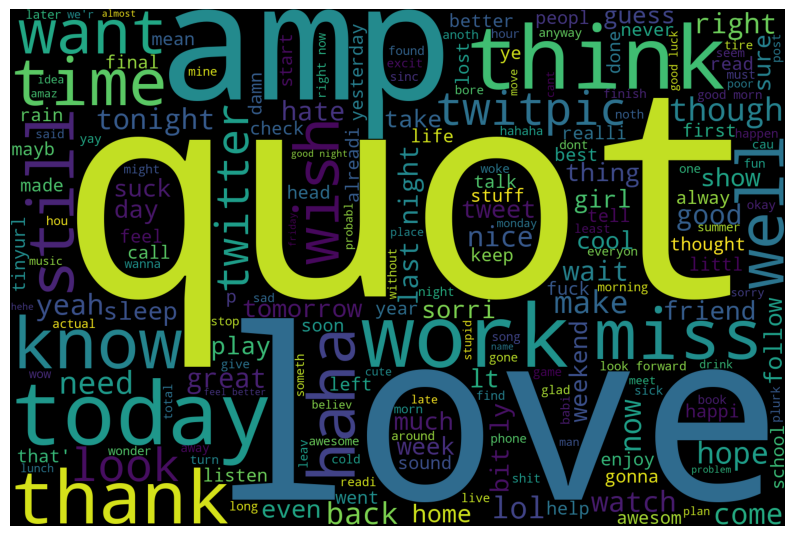

In [15]:
createWrdCloudForSentiment(-1)

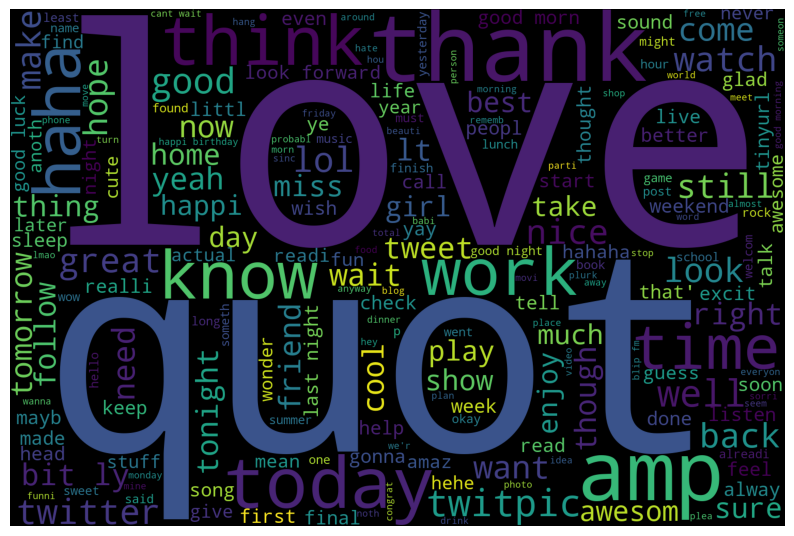

In [16]:
createWrdCloudForSentiment(1) 

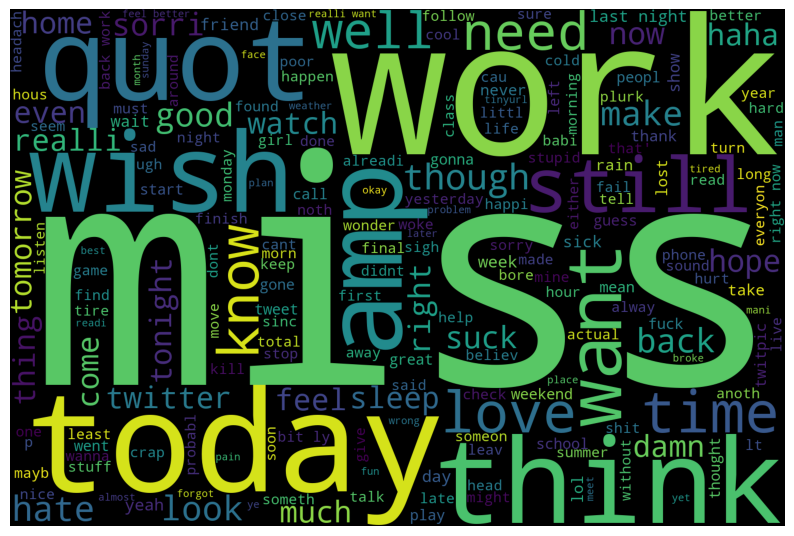

In [17]:
createWrdCloudForSentiment(0) 

In [15]:
# Data balance
def createPieChartFor(t_df):
    Lst = 100*t_df.value_counts()/len(t_df)
    
    # set data for pie chart
    labels = t_df.value_counts().index.values
    sizes =  Lst 
    
    # set labels
    fig1, ax1 = plt.subplots()
    ax1.pie(sizes, labels=labels, autopct='%1.2f%%', shadow=True, startangle=90)
    ax1.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
    plt.show()

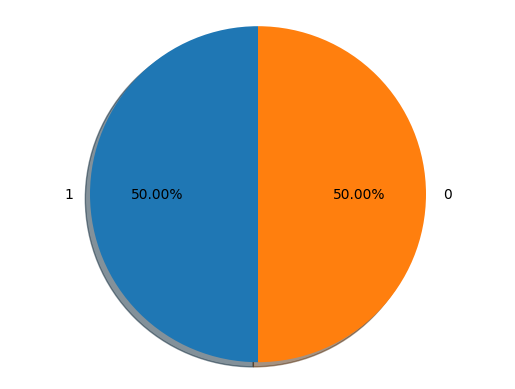

In [16]:
createPieChartFor(tweet_df.target)

In [17]:
train_df, test_df = train_test_split(tweet_df, test_size=0.3, random_state=42)

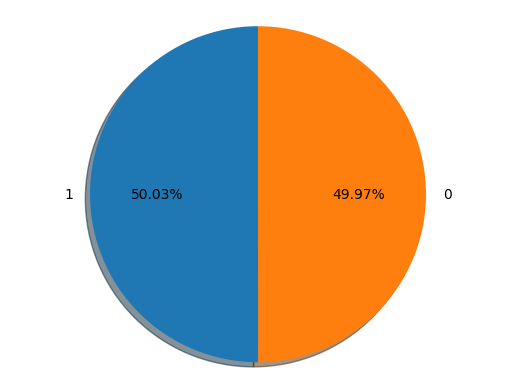

In [18]:
createPieChartFor(train_df.target)

In [126]:
# train_tweets =[]
# for tweet in train_df.clean_tweet:
#     train_tweets.append(tweet)
    
# test_tweets =[]
# for tweet in test_df.clean_tweet:
#     test_tweets.append(tweet)

In [127]:
# train_tweets[:10]

["rant day-peopl spell name right. examples-mi fiance' entir family, realtor, peopl repli emails,",
 "bore day.. hangin' bestiez &lt;3 that' main thing. went shop found bday prezzi",
 'church...it hurt talk',
 'sadli gutsach scof homemad cake',
 'traceydarl yeeess. sneaki',
 "tfss don't?",
 'well, game cancel kinda suck realli',
 'turnerz haha classi least &quot;buttsecks&quot;. interest actual neighborhood &quot;voodoo&quot; follow &quot;wireless&quot;',
 'back awesom proof show work thru storm life...literally! hahaha',
 'alexandramus nite alex....u sing, colleg lol. time man...cant wait finish!!! sweetdream xxxx']

In [128]:
# print(f'train_tweets--{train_tweets}')

train_tweets--["rant day-peopl spell name right. examples-mi fiance' entir family, realtor, peopl repli emails,", "bore day.. hangin' bestiez &lt;3 that' main thing. went shop found bday prezzi", 'church...it hurt talk', 'sadli gutsach scof homemad cake', 'traceydarl yeeess. sneaki', "tfss don't?", 'well, game cancel kinda suck realli', 'turnerz haha classi least &quot;buttsecks&quot;. interest actual neighborhood &quot;voodoo&quot; follow &quot;wireless&quot;', 'back awesom proof show work thru storm life...literally! hahaha', 'alexandramus nite alex....u sing, colleg lol. time man...cant wait finish!!! sweetdream xxxx', 'robbyslaught gonna start hangin lobbi meet them!', 'wanna work straighten hair today.', 'sleep. valkyri profile: coven plume littl complex. http://plurk.com/p/z5p4x', 'comerci gaav finger', 'unhappi today. watch citi tonight', 'want take down...but tire', 'ugh, miss girlfriend', 'good work morning.', 'amygriz excit watch play golf tomorrow', 'beer.. gloriou', 'crazi 

In [19]:
# print(f'tweet_df--{tweet_df}')
tweet_df.head(10)
tweet_df.tail()

,target,TweetText,clean_tweet
499995,0,@sleslicountmein wtf. &amp; i've always wanted...,sleslicountmein wtf. &amp; alway want tattoo p...
499996,0,"@heyitsMade : I have no idea, I'm using web no...","heyitsmad idea, tweetdeck work?"
499997,0,ww didn't work...i gained it all back i pro...,work...i gain back probabl chip anyway
499998,0,@dolphinnancy sorry mommy i miss you too!,dolphinn sorri mommi miss too!
499999,0,I had terrible headache last night.... and my ...,terribl headach last night.... weight decrease...


In [20]:
tweet_df.head()
tweet_df.shape

(1000000, 3)

In [21]:
from sklearn.pipeline import make_pipeline
model = make_pipeline(TfidfVectorizer(), MultinomialNB())

In [22]:
from sklearn.model_selection import train_test_split
X = tweet_df['clean_tweet']
y = tweet_df['target']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.05, random_state=42)

print(X_train.shape,X_test.shape,y_train.shape,y_test.shape)

(950000,) (50000,) (950000,) (50000,)


In [23]:
y_train.value_counts()

target
0    475176
1    474824
Name: count, dtype: int64

In [28]:
model = make_pipeline(TfidfVectorizer(), MultinomialNB())

In [29]:
model.fit(X_train,y_train)

Pipeline(steps=[('tfidfvectorizer', TfidfVectorizer()),
                ('multinomialnb', MultinomialNB())])

In [30]:
validation = model.predict(X_test)

In [31]:
validation1 = model.predict(X_train)

In [32]:
from sklearn.metrics import accuracy_score
accuracy_score(y_train, validation1)

0.8303484210526316

In [33]:
from sklearn.metrics import accuracy_score
accuracy_score(y_test, validation)

0.74488

<Axes: >

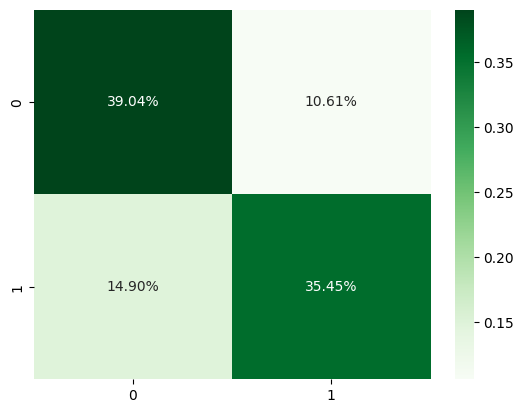

In [34]:
import seaborn as sns
import numpy as np
from sklearn.metrics import confusion_matrix
cf_matrix = confusion_matrix(y_test, validation)
sns.heatmap(cf_matrix/np.sum(cf_matrix), annot=True, fmt='.2%', cmap='Greens')

In [35]:
print(classification_report(y_test, validation))

              precision    recall  f1-score   support

           0       0.72      0.79      0.75     24824
           1       0.77      0.70      0.74     25176

    accuracy                           0.74     50000
   macro avg       0.75      0.75      0.74     50000
weighted avg       0.75      0.74      0.74     50000



In [36]:
train = pd.DataFrame()
train['label'] = y_train
train['text'] = X_train

def predict_category(s, train=X_train, model=model):
    pred = model.predict([s])
    return pred[0]

In [37]:
predict_category("i wanna shot myself")

0

In [39]:
model2 = make_pipeline(TfidfVectorizer(), LogisticRegression())

In [40]:
model2.fit(X_train,y_train)

c:\Users\curio\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\linear_model\_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Pipeline(steps=[('tfidfvectorizer', TfidfVectorizer()),
                ('logisticregression', LogisticRegression())])

In [42]:
validation = model2.predict(X_test)

In [44]:
validation1 = model2.predict(X_train)

In [45]:
from sklearn.metrics import accuracy_score
accuracy_score(y_train, validation1)

0.7964452631578948

In [46]:
from sklearn.metrics import accuracy_score
accuracy_score(y_test, validation)

0.76244

<Axes: >

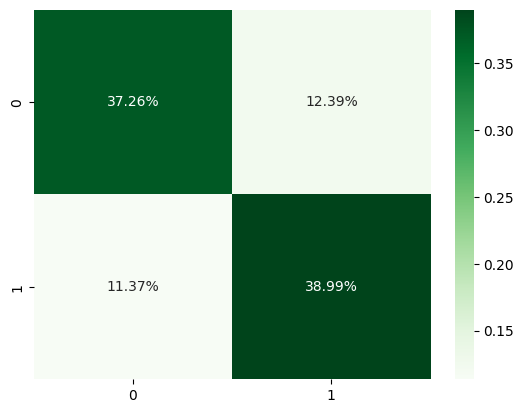

In [47]:
import seaborn as sns
import numpy as np
from sklearn.metrics import confusion_matrix
cf_matrix = confusion_matrix(y_test, validation)
sns.heatmap(cf_matrix/np.sum(cf_matrix), annot=True, fmt='.2%', cmap='Greens')

In [48]:
print(classification_report(y_test, validation))

              precision    recall  f1-score   support

           0       0.77      0.75      0.76     24824
           1       0.76      0.77      0.77     25176

    accuracy                           0.76     50000
   macro avg       0.76      0.76      0.76     50000
weighted avg       0.76      0.76      0.76     50000



In [50]:
train = pd.DataFrame()
train['label'] = y_train
train['text'] = X_train

def predict_category(s, train=X_train, model=model2):
    pred = model2.predict([s])
    return pred[0]

In [52]:
predict_category("i wanna love myself")

1

In [53]:
import pickle
with open('sentiment_model_lr.pkl', 'wb') as file:
    pickle.dump(model2, file)

In [ ]:
model5 = make_pipeline(TfidfVectorizer(), svm.SVC())

In [ ]:
model5.fit(X_train,y_train)

Pipeline(steps=[('tfidfvectorizer', TfidfVectorizer()),
                ('kneighborsclassifier', KNeighborsClassifier())])

In [27]:
validation = model4.predict(X_test)

In [ ]:
from sklearn.metrics import accuracy_score
accuracy_score(y_train, validation1)

In [ ]:
from sklearn.metrics import accuracy_score
accuracy_score(y_test, validation)

In [ ]:
train = pd.DataFrame()
train['label'] = y_train
train['text'] = X_train

def predict_category(s, train=X_train, model=model2):
    pred = model2.predict([s])
    return pred[0]

In [79]:
vectorizer = TfidfVectorizer()
train_tfidf_model = vectorizer.fit_transform(train_tweets)
test_tfidf_model = vectorizer.transform(test_tweets)

In [25]:
train_tfidf = pd.DataFrame(train_tfidf_model.toarray(), columns=vectorizer.get_feature_names_out())
train_tfidf.head()

,00,000,0007,000kg,001,002,003,004,00am,00pm,...,½se,½so,½stand,½t,½tï,½v,½vno,½we,½y,½ï
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [26]:
cls = [LogisticRegression(),
       MultinomialNB(), 
       DecisionTreeClassifier(),
       RandomForestClassifier(n_estimators=1000, random_state=42),
       KNeighborsClassifier(n_neighbors = 5),
       svm.SVC()]

cls_name = []

In [29]:
import pickle
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import MultinomialNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn import svm
from sklearn.metrics import accuracy_score, classification_report

# List of classifiers
cls = [
    LogisticRegression(),
    MultinomialNB(), 
    DecisionTreeClassifier(),
    # KNeighborsClassifier(n_neighbors=5),
    svm.SVC()
]

# Classifier names
cls_names = [
    "LogisticRegression",
    "MultinomialNB",
    "DecisionTreeClassifier",
    # "KNeighborsClassifier",
    "SVM"
]

# Train each model and save
for cl, name in zip(cls, cls_names):
    model = cl.fit(train_tfidf_model, train_df.target)
    with open(f'{name}.pkl', 'wb') as file:
        pickle.dump(model, file)
    print(f"{name} model saved as {name}.pkl")


LogisticRegression model saved as LogisticRegression.pkl
MultinomialNB model saved as MultinomialNB.pkl
DecisionTreeClassifier model saved as DecisionTreeClassifier.pkl
SVM model saved as SVM.pkl


In [30]:
def load_model(model_name):
    with open(f'{model_name}.pkl', 'rb') as file:
        model = pickle.load(file)
    return model

# Example of loading and using a model
model_name = "DecisionTreeClassifier"
loaded_model = load_model(model_name)
lbl_pred = loaded_model.predict(test_tfidf_model)
accuracy = 100 * accuracy_score(lbl_pred, test_df.target)
print(f"{model_name} Accuracy Score: {accuracy:.2f}%")
print(classification_report(lbl_pred, test_df.target))

DecisionTreeClassifier Accuracy Score: 93.55%
              precision    recall  f1-score   support

           0       0.14      0.16      0.15       267
           4       0.97      0.96      0.97      7533

    accuracy                           0.94      7800
   macro avg       0.55      0.56      0.56      7800
weighted avg       0.94      0.94      0.94      7800



In [31]:
# train = pd.DataFrame()
# train['label'] = y_train
# train['text'] = X_train

# def predict_category(s, train=X_train, model=model):
#     pred = model.predict([s])
#     return pred[0]

NameError: name 'y_train' is not defined

In [32]:
vectorizer = TfidfVectorizer()
train_tfidf_model = vectorizer.fit_transform(train_tweets)

# Save the TF-IDF vectorizer
with open('tfidf_vectorizer.pkl', 'wb') as file:
    pickle.dump(vectorizer, file)


In [33]:
def load_tfidf_vectorizer():
    with open('tfidf_vectorizer.pkl', 'rb') as file:
        vectorizer = pickle.load(file)
    return vectorizer

def load_model(model_name):
    with open(f'{model_name}.pkl', 'rb') as file:
        model = pickle.load(file)
    return model

In [34]:
vectoriser=load_tfidf_vectorizer()

In [35]:
def predict_sentiment(text, model_name):
    # Load the TF-IDF vectorizer and the model
    vectorizer = load_tfidf_vectorizer()
    model = load_model(model_name)
    
    # Transform the input text
    input_tfidf = vectorizer.transform([text])
    
    # Make a prediction
    prediction = model.predict(input_tfidf)[0]
    probability = model.predict_proba(input_tfidf)[0]
    
    return prediction, probability


In [37]:
predict_sentiment('love you',loaded_model)

FileNotFoundError: [Errno 2] No such file or directory: 'DecisionTreeClassifier().pkl'

In [42]:
def load_model(model_name):
    with open(f'LogisticRegression.pkl', 'rb') as file:
        model = pickle.load(file)
    return model

In [43]:
lr_model = load_model(LogisticRegression)

In [44]:
predict_sentiment('love you',lr_model)

(4, array([0.00445709, 0.99554291]))

In [51]:
predict_sentiment('my whole body feels itchy and like its on fire ',lr_model)

(1, array([0.07309864, 0.92690136]))

In [46]:
def predict_sentiment(text, model):
    # Load the TF-IDF vectorizer
    vectorizer = load_tfidf_vectorizer()
    
    # Transform the input text
    input_tfidf = vectorizer.transform([text])
    
    # Make a prediction
    prediction = model.predict(input_tfidf)[0]
    probability = model.predict_proba(input_tfidf)[0]
    
    # Adjust the prediction to binary (0 or 1) based on probability threshold
    predicted_class = 1 if probability[1] > 0.5 else 0
    
    return predicted_class, probability

# if __name__ == "__main__":
#     # Load the Logistic Regression model
#     lr_model = load_model("LogisticRegression")

#     # Texts for prediction
#     texts = ["love you", "hate you"]

#     for text in texts:
#         # Predict sentiment
#         prediction, probability = predict_sentiment(text, lr_model)

#         print(f"Text: {text}")
#         print(f"Predicted Class: {prediction}")
#         print(f"Probability: {probability}")
#         print("---")


In [50]:
prediction, probability = predict_sentiment("I'm loving myself", lr_model)
print(f'prediction--{prediction},probability--{probability}')

prediction--1,probability--[0.03547304 0.96452696]
